# Title
The title of the notebook should be coherent with file name. Namely, file name should be:    
*author's initials_progressive number_title.ipynb*    
For example:    
*EF_01_Data Exploration.ipynb*

## Purpose
State the purpose of the notebook.

## Methodology
Quickly describe assumptions and processing steps.

## WIP - improvements
Use this section only if the notebook is not final.

Notable TODOs:
- todo 1;
- todo 2;
- todo 3.

## Results
Describe and comment the most important results.

## Suggested next steps
State suggested next steps, based on results obtained in this notebook.

# Setup

## Library import
We import all the required Python libraries

In [1]:
# Import libraries
import os
from pathlib import Path
import sklearn
import pandas as pd 
import numpy as np 
import seaborn as sns
import matplotlib.pyplot as plt
from IPython.display import HTML
from IPython.display import display
from ydata_profiling import ProfileReport, compare

In [2]:
import hydra
from hydra import initialize, compose
from omegaconf import OmegaConf

In [3]:
%matplotlib inline
import matplotlib
matplotlib.style.use('ggplot')
sns.set()

In [4]:
#hydra.core.global_hydra.GlobalHydra.instance().clear()
with initialize(config_path="../../conf", job_name="prediction", version_base="1.2"):
    conf = compose(config_name="config.yaml", return_hydra_config=True)

## Load dataset

### Load Input features

In [5]:
from src.data.data_loader import DataSet, DatasetProperties
from src.utils.common import UtilsCommon, Features

In [6]:
f_data_features_path = Path(os.path.join(UtilsCommon.get_project_root(), conf.loc_dirs.dir_data, conf.loc_dirs.f_name_data_features_only))

ds_prop_features_only = DatasetProperties(file_path=f_data_features_path)
ds_features_only =  DataSet(props=ds_prop_features_only, delimiter='\t')

In [7]:
ds_features_only.data

,Date Completed / Initials,Print ID #,Printhead ID #,Line Width (um),Substrate Thickness (um),Cartridge Print Height,Nozzle Voltage,Drop Spacing (um),Nozzle #,Jetting Frequency (kHz),...,Ink Density (ρ=g/L),Nozzle Diameter (um),Particle size (nm),z-Number ( √γρD/ η ),Unnamed: 26,Line Width,Roughness,Overspray,Thickness,conductivity
0,02.22.22/ J.K,1,281744.0025.4621.01,150,200,800,25,8,6.0,5,...,1517,21.5,36,5.039074,NaN,NaN,NaN,NaN,NaN,NaN
1,02.22.22/ J.K,2,281744.0025.4621.01,150,200,800,25,9,6.0,5,...,1517,21.5,36,5.039074,NaN,NaN,NaN,NaN,NaN,NaN
2,02.23.22/ A.T,3,281744.0025.4621.01,150,200,800,25,10,8.0,5,...,1517,21.5,36,5.039074,NaN,NaN,NaN,NaN,NaN,NaN
3,02.23.22/ C.F,4,281744.0025.4621.01,150,200,800,25,11,5.0,5,...,1517,21.5,36,5.039074,NaN,NaN,NaN,NaN,NaN,NaN
4,02.23.22/ C.F,5,281744.0025.4621.01,150,200,800,25,12,7.0,5,...,1517,21.5,36,5.039074,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
361,NaN,357,NaN,150,200,550,40,13,NaN,5,...,1526,21.5,38,5.328373,NaN,NaN,NaN,NaN,NaN,NaN
362,NaN,358,NaN,150,200,550,40,14,NaN,5,...,1526,21.5,38,5.328373,NaN,NaN,NaN,NaN,NaN,NaN
363,NaN,359,NaN,150,200,550,40,15,NaN,5,...,1526,21.5,38,5.328373,NaN,NaN,NaN,NaN,NaN,NaN
364,NaN,360,NaN,150,200,550,40,16,NaN,5,...,1526,21.5,38,5.328373,NaN,NaN,NaN,NaN,NaN,NaN


In [11]:
ds_features_only.data.columns

Index(['initials', 'print_id', 'print_head_id', 'line_width',
       'substrate_thickness', 'print_height', 'nozzle_voltage', 'drop_spacing',
       'nozzle_id', 'jetting_freq', 'distance', 'time', 'velocity', 'notes',
       'platen_temperature', 'cartridge_temperature', 'waveform_file',
       'no_of_layers', 'ink_visco_cp', 'ink_visco_pas',
       'surface_tension_dyne_cm', 'surface_tension_n_m', 'ink _density',
       'nozzle_diameter', 'particle_size', 'z_number', 'Unnamed: 26',
       'line_width', 'roughness', 'overspray', 'thickness', 'conductivity'],
      dtype='object')

In [8]:
# Fix column names
ds_features_only.data.rename(columns= Features.get_all_column_name_map(), inplace=True)


In [9]:
# Remove target columns
ds_features_only.data.drop(Features.get_target_columns(), axis=1, inplace=True)

### Load Targert data

In [10]:
f_data_target_path = Path(os.path.join(UtilsCommon.get_project_root(), conf.loc_dirs.dir_data, conf.loc_dirs.f_name_data_target_partial_feature))

ds_prop_target_only = DatasetProperties(file_path=f_data_target_path)
ds_target_only =  DataSet(props=ds_prop_target_only, index_col=[0])

In [11]:
ds_target_only.data.rename(columns= Features.get_all_column_name_map(), inplace=True)

In [12]:
colmns_overlap = list(set(ds_features_only.data.columns).intersection(set(ds_target_only.data.columns))- set(['print_id']))
ds_target_only.data.drop(colmns_overlap, axis=1, inplace=True)

### Merge Features and Target and EDA

In [13]:
ds_features_target = DataSet()
ds_features_target.data = pd.merge(ds_features_only.data, ds_target_only.data , on='print_id',how='right')

In [14]:
ds_features_target.data

,initials,print_id,print_head_id,substrate_thickness,print_height,nozzle_voltage,drop_spacing,nozzle_id,jetting_freq,distance,...,ink _density,nozzle_diameter,particle_size,z_number,Unnamed: 26,thickness,conductivity,line_width,overspray,roughness
0,02.22.22/ J.K,1,281744.0025.4621.01,200,800,25,8,6.0,5,270,...,1517,21.5,36,5.039074,NaN,NaN,NaN,294,12,164
1,02.22.22/ J.K,2,281744.0025.4621.01,200,800,25,9,6.0,5,270,...,1517,21.5,36,5.039074,NaN,NaN,NaN,261,136,141
2,02.23.22/ A.T,3,281744.0025.4621.01,200,800,25,10,8.0,5,300,...,1517,21.5,36,5.039074,NaN,NaN,NaN,218,11,103
3,02.23.22/ C.F,4,281744.0025.4621.01,200,800,25,11,5.0,5,300,...,1517,21.5,36,5.039074,NaN,NaN,NaN,190,15,68
4,02.23.22/ C.F,5,281744.0025.4621.01,200,800,25,12,7.0,5,300,...,1517,21.5,36,5.039074,NaN,NaN,NaN,190,91,90
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
206,05.31.22 / C.F,205,281985.0232.3621.01,200,650,31,12,11.0,5,900,...,1614,21.5,36,4.852027,NaN,NaN,NaN,262,17,94
207,05.31.22 / C.F,206,281985.0232.3621.01,200,650,31,13,11.0,5,900,...,1614,21.5,36,4.852027,NaN,NaN,NaN,241,15,86
208,05.31.22 / C.F,207,281985.0232.3621.01,200,650,31,14,11.0,5,900,...,1614,21.5,36,4.852027,NaN,NaN,NaN,191,77,87
209,06.02.22 / C.F,209,281744.0021.4621.01,200,650,31,16,10.0,5,900,...,1614,21.5,36,4.852027,NaN,NaN,NaN,188,1,73


<AxesSubplot:title={'center':'Number of missing values in each column'}>

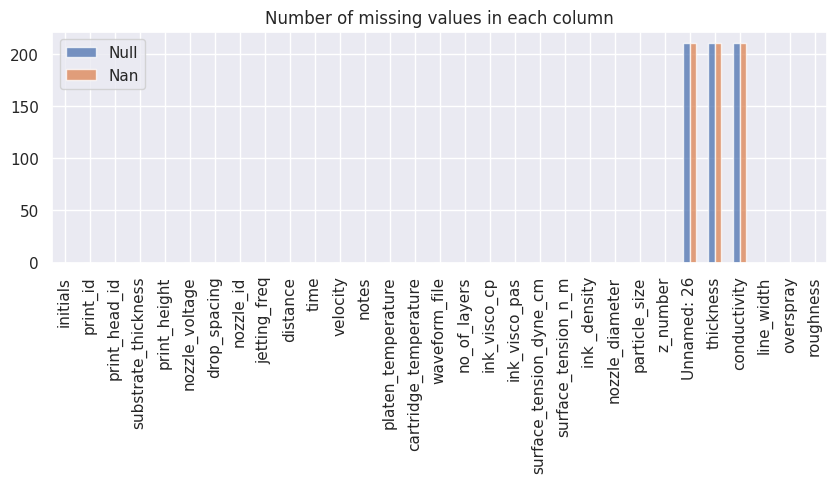

In [15]:
pd.concat([ds_features_target.data.isnull().sum(), ds_features_target.data.isna().sum()], axis=1, keys=['Null', 'Nan']).plot(
    kind = 'bar', rot = 90, alpha = 0.75, figsize = (10, 3), title = 'Number of missing values in each column')

/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/sweetviz/dataframe_report.py:74: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  all_source_names = [cur_name for cur_name, cur_series in source_df.iteritems()]
/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/sweetviz/dataframe_report.py:109: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  filtered_series_names_in_source = [cur_name for cur_name, cur_series in source_df.iteritems()


                                             |          | [  0%]   00:00 -> (? left)

/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/sweetviz/series_analyzer_cat.py:28: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for item in category_counts.iteritems():
/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/sweetviz/series_analyzer_numeric.py:25: FutureWarning: The 'mad' method is deprecated and will be removed in a future version. To compute the same result, you may do `(df - df.mean()).abs().mean()`.
  stats["mad"] = series.mad()
/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/sweetviz/series_analyzer_cat.py:28: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for item in category_counts.iteritems():
/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/sweetviz/series_analyzer_cat.py:28: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
 


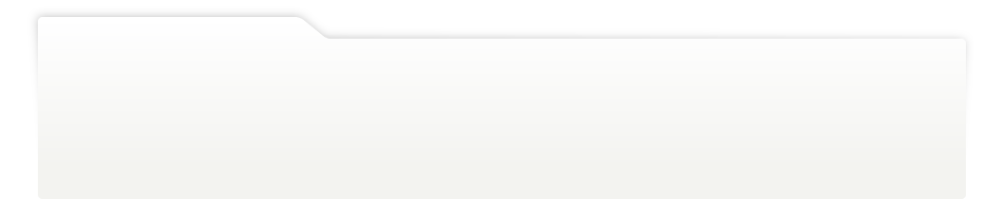
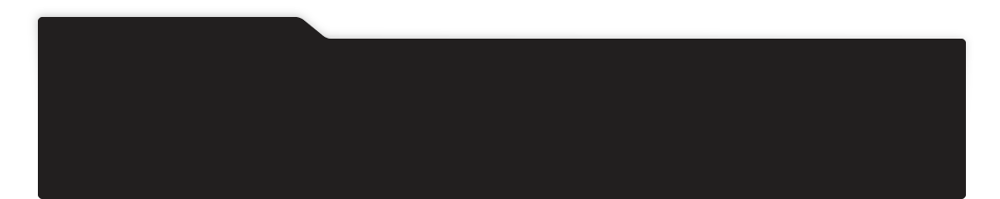
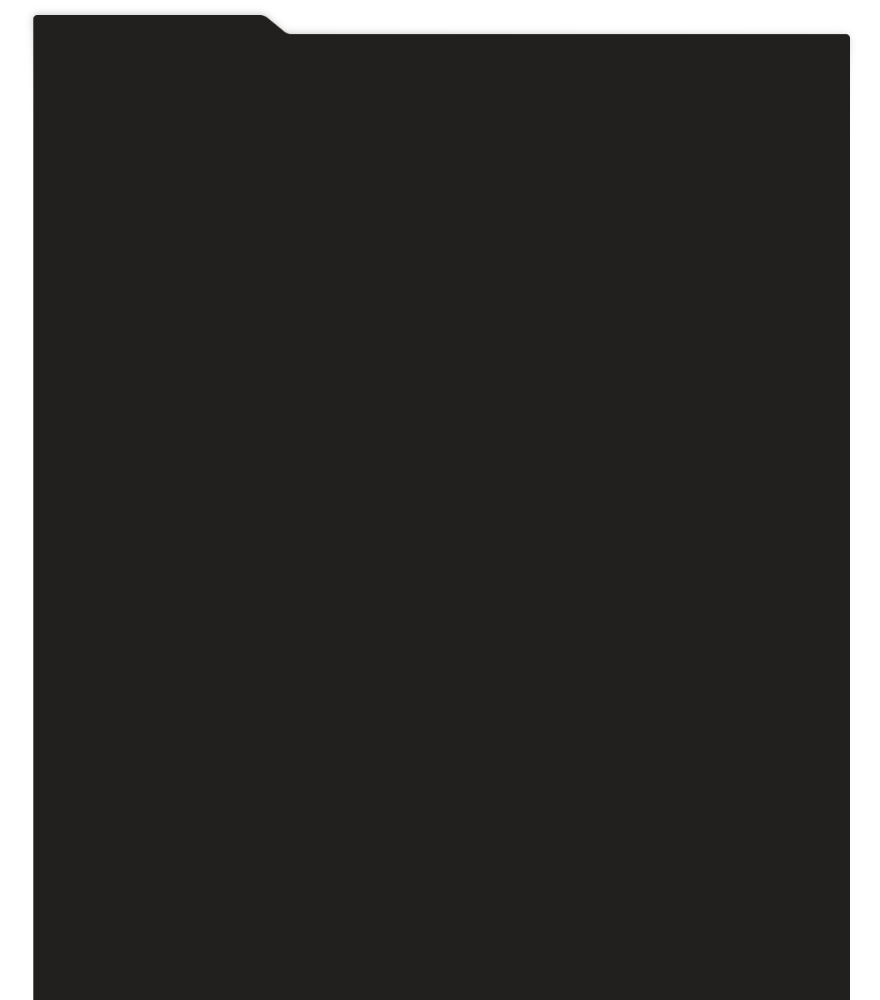
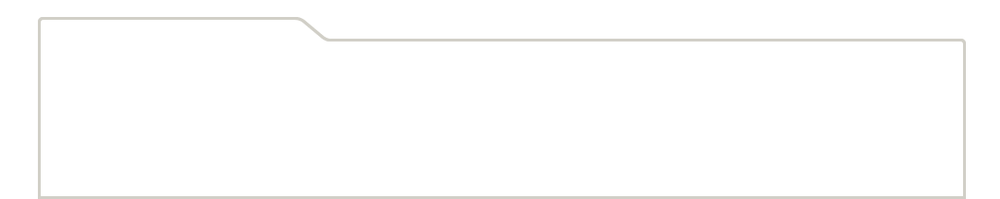
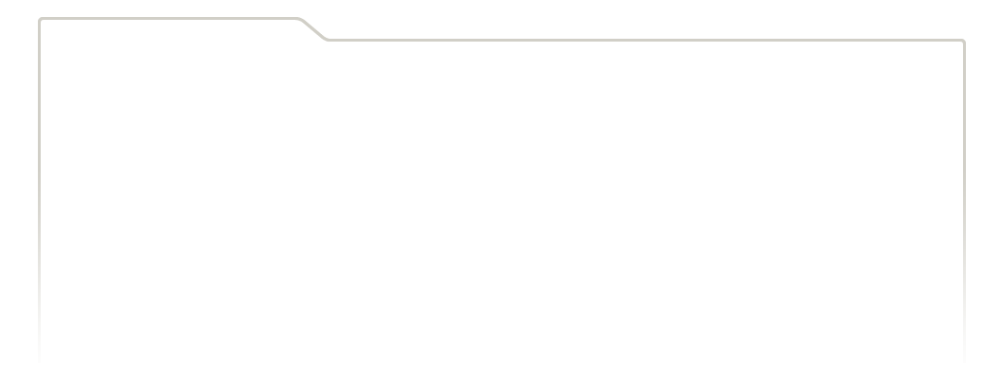
...
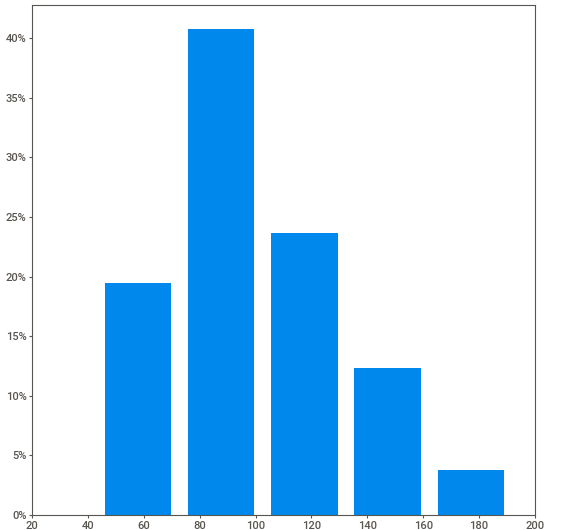
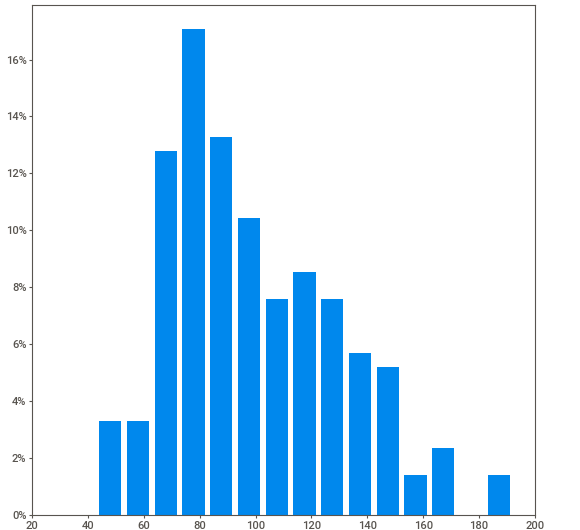
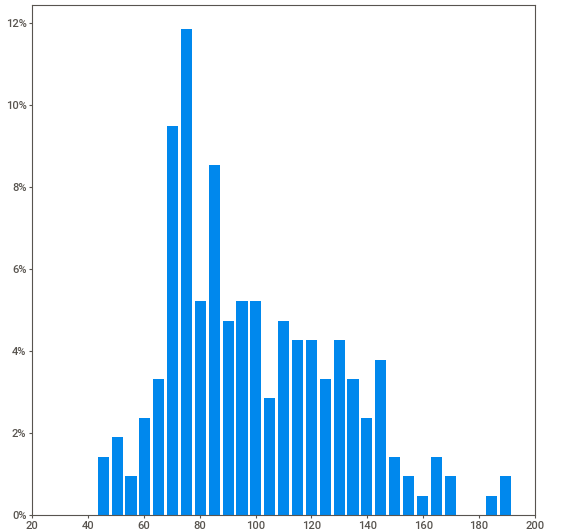
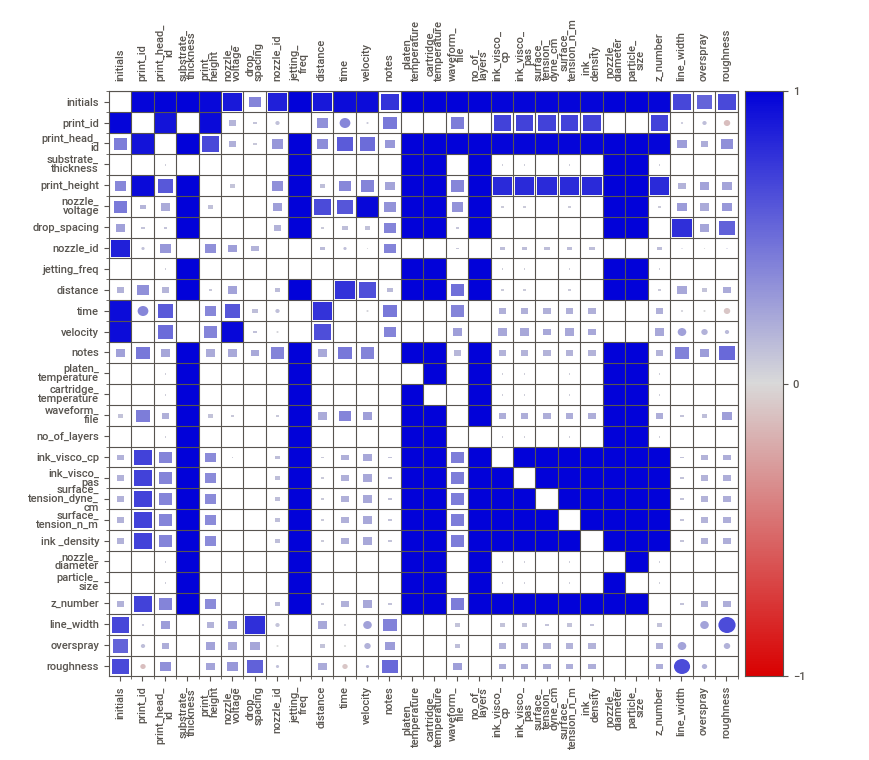
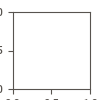

In [16]:
import sweetviz as sv
my_report = sv.analyze(ds_features_target.data)
my_report.show_notebook(w=None, h=400, scale=None, layout='vertical', filepath=None)

### Remove NaN or Null

In [17]:
ds_features_target.data.replace('-', np.NaN, inplace=True)
ds_features_target.data.replace([np.inf, -np.inf], np.NaN, inplace=True)

<AxesSubplot:title={'center':'Number of missing values in each column'}>

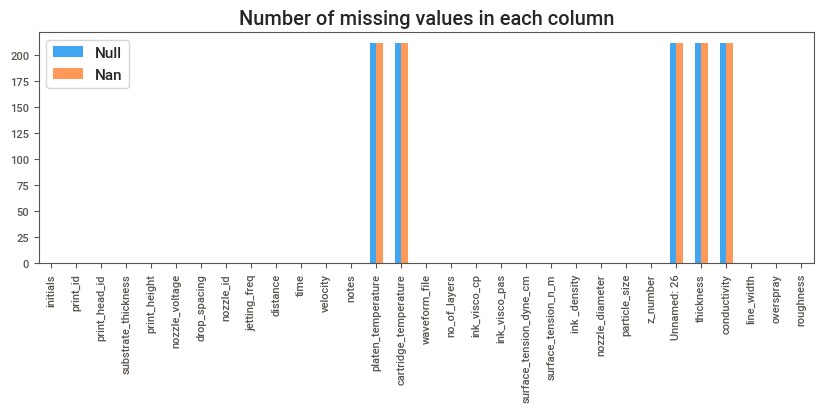

In [18]:
pd.concat([ds_features_target.data.isnull().sum(), ds_features_target.data.isna().sum()], axis=1, keys=['Null', 'Nan']).plot(
    kind = 'bar', rot = 90, alpha = 0.75, figsize = (10, 3), title = 'Number of missing values in each column')

### Columns with constant valdues

In [19]:
# Constant columns
ds_features_target.data[['nozzle_diameter', 'jetting_freq', 'substrate_thickness',
                    'no_of_layers', 'particle_size']].describe()

,nozzle_diameter,jetting_freq,substrate_thickness,no_of_layers,particle_size
count,211.0,211.0,211.0,211.0,211.0
mean,21.5,5.0,200.0,1.0,36.0
std,0.0,0.0,0.0,0.0,0.0
min,21.5,5.0,200.0,1.0,36.0
25%,21.5,5.0,200.0,1.0,36.0
50%,21.5,5.0,200.0,1.0,36.0
75%,21.5,5.0,200.0,1.0,36.0
max,21.5,5.0,200.0,1.0,36.0


### Corelated columns

/tmp/ipykernel_1280684/3373196485.py:2: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  plot_correlation(ds_features_target.data[



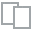
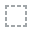
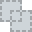
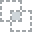
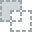
...
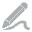
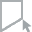
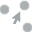
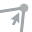
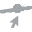

In [20]:
from dataprep.eda import plot_correlation
plot_correlation(ds_features_target.data[
    set(ds_features_target.data.columns) -  
    set(Features.get_nan_features()+ Features.get_id_features()+ Features.get_meta_data_features()+ Features.get_const_value_features())
    ].corr())

### Remove Unnecessary features

In [21]:
ds_features_target.data.drop(
    Features.get_nan_features()+
    Features.get_id_features()+
    Features.get_meta_data_features()+
    Features.get_const_value_features()+
    Features.get_corelated_features(), 
    axis=1, inplace=True
    )

In [22]:
ds_prop_feature_target = DatasetProperties()
ds_features_target.prop = ds_prop_feature_target

ds_features_target.prop.feature_columns = list(set(ds_features_target.data.columns.values.tolist()) - set(Features.get_target_columns()))
ds_features_target.prop.target_cols = tuple(Features.get_target_columns())

### Outlier removal

In [23]:
ds_features_target.data.drop(ds_features_target.data.index[ds_features_target.data['overspray'] > conf.feature_range.high.overspray], inplace=True)

In [24]:
ds_features_target.data.reset_index(drop=True, inplace=True)
ds_features_target.data.to_csv(os.path.join(UtilsCommon.get_project_root(), conf.loc_dirs.dir_data, conf.loc_dirs.f_name_data_feature_target_clean+ '.tsv'), sep='\t')

### Final statistics

  0%|          | 0/1344 [00:00<?, ?it/s]

/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


DataPrep Report
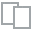
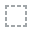
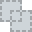
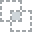
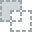
...
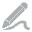
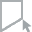
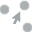
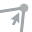
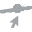

In [25]:
from dataprep.eda import create_report
create_report(ds_features_target.data)

## Oversampling

In [26]:
from src.data.preprocessing import Preprocessing, PreprocessingConfig

In [27]:
from imblearn.over_sampling import SMOTE, RandomOverSampler
import ImbalancedLearningRegression as iblr
import smogn

In [28]:
conf_preprocessing = PreprocessingConfig()
preprocessor = Preprocessing(ds_features_target.data, conf_preprocessing)

### SMOTE - 1 (balance)

In [30]:
param_smoter = {
    'k' : 7,                    ## num of neighs for over-sampling (pos int)
    'pert' : 0.07,              ## perturbation / noise percentage (pos real)
    'samp_method' : "balance",  ## over / under sampling ("balance" or extreme")
    'under_samp' : True,        ## under sampling (bool)
    'drop_na_col' : False,       ## auto drop columns with nan's (bool)
    'drop_na_row' : False,       ## auto drop rows with nan's (bool)
    'replace' : False,          ## sampling replacement (bool)
    #'seed' : conf.project_var.seed_random,              ## seed for random sampling (pos int or None)
    
    ## phi relevance function arguments / inputs
    'rel_thres' : 0.5,          ## relevance threshold considered rare (pos real)
    'rel_method' : "auto",      ## relevance method ("auto" or "manual")
    'rel_xtrm_type' : "both",   ## distribution focus ("high", "low", "both")
    'rel_coef' : 1.5,           ## coefficient for box plot (pos real)
    'rel_ctrl_pts_rg' : None    ## input for "manual" rel method  (2d array)    
    }
df_oversampled_line_width = preprocessor.oversample_data(data = ds_features_target.data, target_column = 'line_width', **param_smoter)
df_oversampled_overspray = preprocessor.oversample_data(data = ds_features_target.data, target_column = 'overspray', **param_smoter)
df_oversamoled_roughness = preprocessor.oversample_data(data = ds_features_target.data, target_column = 'roughness', **param_smoter)

/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/smogn/smoter.py:201: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  b_index.update({i: y_sort[bumps[i]:bumps[i + 1]]})
r_index: 100%|##########| 18/18 [00:00<00:00, 677.07it/s]
/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/smogn/smoter.py:289: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  data_new.iloc[:, j] = data_new.iloc[:, j].astype(feat_dtypes_orig[j])
/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/

In [31]:
df_all_over_sampled = pd.concat([df_oversampled_line_width, df_oversampled_overspray, df_oversamoled_roughness])
df_all_over_sampled.to_csv(os.path.join(UtilsCommon.get_project_root(), conf.loc_dirs.dir_data, conf.loc_dirs.f_name_data_oversample_feature_target_clean+ '_balance.tsv'), sep='\t')

### SMOTE 2

In [34]:
param_smoter = {
    'k' : 7,                    ## num of neighs for over-sampling (pos int)
    'pert' : 0.07,              ## perturbation / noise percentage (pos real)
    'samp_method' : "extreme",  ## over / under sampling ("balance" or extreme")
    'under_samp' : True,        ## under sampling (bool)
    'drop_na_col' : False,       ## auto drop columns with nan's (bool)
    'drop_na_row' : False,       ## auto drop rows with nan's (bool)
    'replace' : False,          ## sampling replacement (bool)
    #'seed' : conf.project_var.seed_random,              ## seed for random sampling (pos int or None)
    
    ## phi relevance function arguments / inputs
    'rel_thres' : 0.5,          ## relevance threshold considered rare (pos real)
    'rel_method' : "auto",      ## relevance method ("auto" or "manual")
    'rel_xtrm_type' : "both",   ## distribution focus ("high", "low", "both")
    'rel_coef' : 1.5,           ## coefficient for box plot (pos real)
    'rel_ctrl_pts_rg' : None    ## input for "manual" rel method  (2d array)    
    }
df_oversampled_line_width = preprocessor.oversample_data(data = ds_features_target.data, target_column = 'line_width', **param_smoter)
df_oversampled_overspray = preprocessor.oversample_data(data = ds_features_target.data,target_column = 'overspray', **param_smoter)
df_oversamoled_roughness = preprocessor.oversample_data(data = ds_features_target.data, target_column = 'roughness', **param_smoter)

/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/smogn/smoter.py:201: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  b_index.update({i: y_sort[bumps[i]:bumps[i + 1]]})
r_index: 100%|##########| 12/12 [00:00<00:00, 639.22it/s]
/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/smogn/smoter.py:289: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  data_new.iloc[:, j] = data_new.iloc[:, j].astype(feat_dtypes_orig[j])
/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/

In [35]:
df_all_over_sampled = pd.concat([df_oversampled_line_width, df_oversampled_overspray, df_oversamoled_roughness])
df_all_over_sampled.to_csv(os.path.join(UtilsCommon.get_project_root(), conf.loc_dirs.dir_data, conf.loc_dirs.f_name_data_oversample_feature_target_clean+ '_extreme.tsv'), sep='\t')

### Report compare

In [36]:
profile_report_original_ds = ProfileReport(ds_features_target.data, title='Original Dataset')
profile_report_oversampled_ds = ProfileReport(df_all_over_sampled, title='Oversampled Dataset')

profile_comparison_report = profile_report_original_ds.compare(profile_report_oversampled_ds)
profile_comparison_report.to_file(os.path.join(UtilsCommon.get_project_root(), conf.loc_dirs.dir_report_data, 'compare_oversample_extreme.html'))


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/ydata_profiling/model/pandas/discretize_pandas.py:52: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  discretized_df.loc[:, column] = self._discretize_column(


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/ydata_profiling/model/pandas/discretize_pandas.py:52: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  discretized_df.loc[:, column] = self._discretize_column(
/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/ydata_profiling/model/pandas/correlations_pandas.py:84: FutureWarning: reindexing with a non-unique Index is deprecated and will raise in a future version.
  return _cramers_corrected_stat(pd.crosstab(col_1, col_2), correction=True)
/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/ydata_profiling/model/correlations.py:66: UserWarning: There was an attempt to calculate the auto correlation, but this failed.
To hide this warning, disable the calculation
(using 

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [37]:
profile_comparison_report.get_description().keys()

dict_keys(['analysis', 'table', 'variables', 'scatter', 'correlations', 'missing', 'alerts', 'package', 'sample', 'duplicates'])

In [ ]:
ds_features_target.prop.

In [14]:
ds_original.data.replace('-', np.NaN, inplace=True)
ds_original.data.replace([np.inf, -np.inf], np.NaN, inplace=True)

In [ ]:
from ydata_profiling import ProfileReport
profile = ProfileReport(ds_original.data, title="Profiling Report")
profile.to_notebook_iframe()

In [ ]:
import sweetviz as sv
my_report = sv.analyze(my_dataframe)
my_report.show_notebook()

<AxesSubplot:title={'center':'Number of missing values in each column'}>

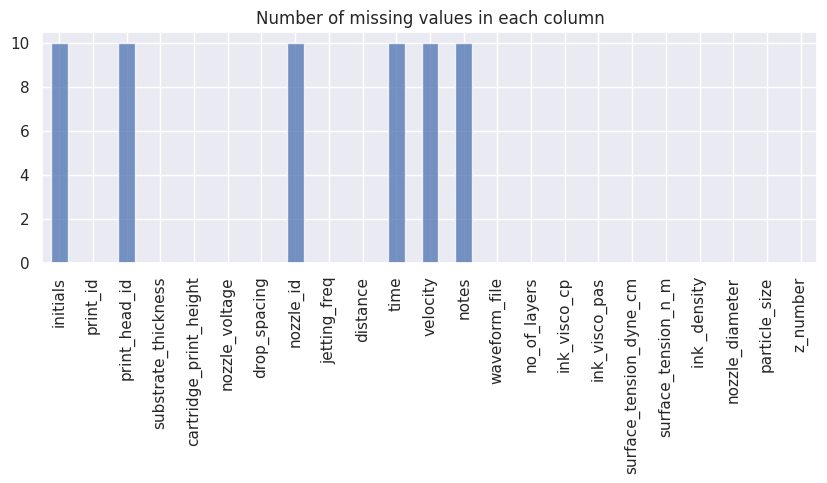

In [17]:
ds_original.data.isnull().sum().plot(kind = 'bar', rot = 90, alpha = 0.75, figsize = (10, 3), title = 'Number of missing values in each column')

In [16]:
# Removing all the columns with missing values and target columns
ds_original.data.drop(['platen_temperature', 'cartridge_temperature', 'Unnamed: 26', 'line_width', 'roughness', 'overspray', 'thickness', 'conductivity'], axis=1, inplace=True)

In [ ]:
corrMatrix = df_all_features_print[list_inp_features].corr()
fig, ax = plt.subplots(figsize=(10,8)) 
sns.heatmap(corrMatrix, annot=True, linewidths=.01, ax=ax)
plt.show()

corrMatrix = df_all_features_print[list_opt_features].corr()
sns.heatmap(corrMatrix, annot=True)
plt.show()

corrMatrix = df_all_features_print[list_inp_features+list_opt_features].corr()
fig, ax = plt.subplots(figsize=(15,10)) 
sns.heatmap(corrMatrix, annot=True, linewidths=.01, ax=ax)
plt.show()

In [8]:
f_database = r'../../data/processed/microscopic_imgs/cropped_clean/db'
Print_Database= pd.read_csv(f_database+"/"+'Print_Database_ML.csv',index_col=[0])

df_raw_input = pd.read_csv(f_database+"/"+'JS_A191_dataset_2023_4_4.tsv',index_col=None, delimiter='\t')

In [9]:
df_raw_input.drop('Unnamed: 26', axis=1, inplace=True)

In [10]:
df_raw_input.rename(columns={'Date Completed / Initials':'initials',  '  Print ID #': 'print_id', 'Printhead ID #': 'print_head_id',
                            'Line Width (um)': 'line_width', 'Substrate Thickness (um)': 'substrate_thickness',
                            'Cartridge Print Height': 'cartridge_print_height', 'Nozzle Voltage': 'nozzle_voltage',
       'Drop Spacing (um)': 'drop_spacing', 'Nozzle #': 'nozzle_id', 'Jetting Frequency (kHz)': 'jetting_freq',
       'Distance  (um)': 'distance',
       'Time (us)': 'time', 'Velocity (m/s) ':'velocity', 'Notes': 'notes', 'Platen  Temperature' : 'platen_temperature',
       'Cartridge Temperature': 'cartridge_temperature', 'Waveform File': 'waveform_file', 'Number of Layers': 'no_of_layers',
       'Ink  Viscosity (cP) (η)': 'ink_visco_cp', 'Ink  Viscosity (Pa*s) (η)': 'ink_visco_pas',
       'Surface  Tension (dyne/cm) (γ)': 'surface_tension_dyne_cm', 'Surface Tension (N/m) (γ)': 'surface_tension_n_m',
       'Ink  Density (ρ=g/L)': 'ink _density', 'Nozzle  Diameter (um)': 'nozzle_diameter', 'Particle size (nm)' : 'particle_size',
       'z-Number  ( √γρD/ η )': 'z_number', 'Line Width': 'line_width', 'Roughness': 'roughness', 'Overspray': 'overspray',
       'Thickness': 'thickness', 'conductivity': 'conductivity'}, inplace=True)

Print_Database.rename(columns={'Print ID': 'print_id', 
                               'Print Height': 'print_height', 'Nozzle Voltage': 'nozzle_voltage', 
                               'Drop Spacing': 'drop_spacing', 'Line Width': 'line_width', 
                               'Overspray':'overspray', 'Roughness': 'roughness'}, inplace=True)

df_raw_input.drop(['line_width', 'roughness', 'overspray', 'thickness', 'conductivity'], axis=1, inplace=True)

In [11]:
df_all_features_print = pd.merge(Print_Database, df_raw_input, on='print_id',how='left')

In [19]:
list_opt_features = ['line_width', 'roughness', 'overspray', 'thickness', 'conductivity']
# 'nozzle_diameter' all has same value of 21.5, 
# 'jetting_freq' all has same value of 5
# 'substrate_thickness' all has same value of 200
# no_of_layers 1
# particle_size 36
list_id_features = ['print_id', 'print_head_id', 'nozzle_id','notes', 'initials', 
                    'waveform_file', 'nozzle_diameter', 'jetting_freq', 'substrate_thickness',
                    'no_of_layers', 'particle_size'] 
list_corelated_features = ['z_number',  'ink_visco_pas', 'surface_tension_n_m', 'nozzle_voltage', 'drop_spacing', 'print_height']

list_inp_features  = list(set(ds_original.data.columns) - set(list_id_features+list_opt_features+list_corelated_features))

[list_opt_features.remove(x) for x in ['thickness', 'conductivity']]

[list_inp_features.remove(x) for x in ['platen_temperature', 'cartridge_temperature']]

ValueError: list.remove(x): x not in list

In [20]:
list_inp_features

['distance',
 'surface_tension_dyne_cm',
 'ink _density',
 'time',
 'ink_visco_cp',
 'velocity',
 'cartridge_print_height']

# Existing Methods [MLPRegressor]

## EDA

In [13]:
df_all_features_print.replace('-', np.NaN, inplace=True)
df_all_features_print.replace([np.inf, -np.inf], np.NaN, inplace=True)

In [14]:
df_all_features_print[list_inp_features].isna().sum()

nozzle_voltage_x           0
distance                   0
ink_visco_cp               0
ink _density               0
velocity                   0
drop_spacing_x             0
surface_tension_dyne_cm    0
drop_spacing_y             0
time                       0
cartridge_print_height     0
nozzle_voltage_y           0
dtype: int64

In [28]:
# https://machinelearningmastery.com/quick-and-dirty-data-analysis-with-pandas/ 
ds_original.data[ds_original.data.columns].describe().T.sort_values(by='std', ascending=True)

,count,mean,std,min,25%,50%,75%,max
substrate_thickness,366.0,200.000000,0.000000,200.000000,200.000000,200.000000,200.000000,200.000000
nozzle_diameter,366.0,21.500000,0.000000,21.500000,21.500000,21.500000,21.500000,21.500000
jetting_freq,366.0,5.000000,0.000000,5.000000,5.000000,5.000000,5.000000,5.000000
no_of_layers,366.0,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000
ink_visco_pas,366.0,0.006697,0.000323,0.006100,0.006300,0.006900,0.006900,0.006900
surface_tension_n_m,366.0,0.032086,0.000485,0.030900,0.032200,0.032300,0.032300,0.032300
z_number,366.0,4.918099,0.195747,4.717899,4.852027,4.852027,5.039074,5.328373
ink_visco_cp,366.0,6.696721,0.323322,6.100000,6.300000,6.900000,6.900000,6.900000
surface_tension_dyne_cm,366.0,32.086339,0.484702,30.900000,32.200000,32.300000,32.300000,32.300000
particle_size,366.0,36.295082,0.710260,36.000000,36.000000,36.000000,36.000000,38.000000


/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/seaborn/categorical.py:470: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  plot_data = [np.asarray(s, float) for k, s in iter_data]


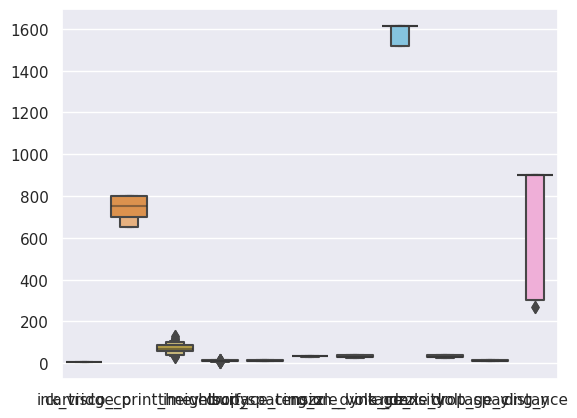

In [13]:
sns.boxenplot(df_all_features_print[list_inp_features])
plt.show()

/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/seaborn/categorical.py:470: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  plot_data = [np.asarray(s, float) for k, s in iter_data]


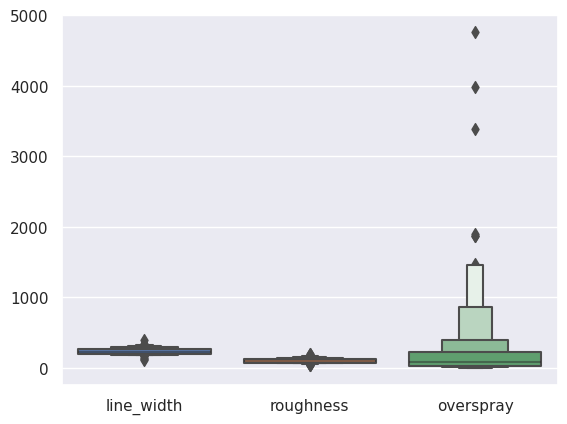

In [14]:
#plt.boxplot(Print_Database['Line Width','Overspray','Roughness'],widths=(0.2))
# Print_Database.boxplot(column=['Line Width','Overspray','Roughness'],widths=(0.5))
# plt.show()

sns.boxenplot(df_all_features_print[list_opt_features])
plt.show()

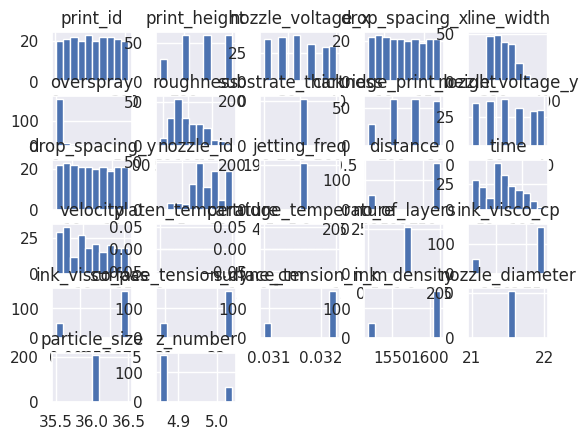

In [15]:
df_all_features_print.hist()

plt.hist(df_all_features_print['line_width'])
plt.title('Line Width Histogram')
plt.show()

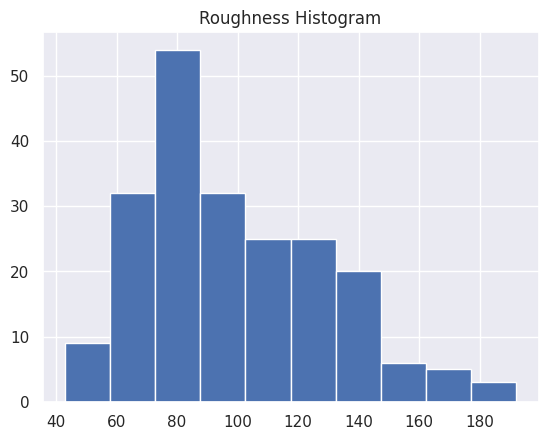

In [17]:
plt.hist(df_all_features_print['roughness'])
plt.title('Roughness Histogram')
plt.show()

In [18]:
df_high_Overspray = df_all_features_print[df_all_features_print['overspray'] > 500]

(array([9., 5., 2., 3., 0., 0., 1., 0., 1., 1.]),
 array([ 523. ,  946.9, 1370.8, 1794.7, 2218.6, 2642.5, 3066.4, 3490.3,
        3914.2, 4338.1, 4762. ]),
 <BarContainer object of 10 artists>)

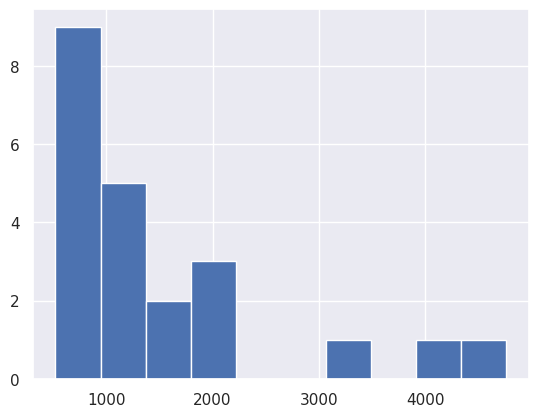

In [19]:
plt.hist(df_high_Overspray['overspray'])

In [16]:
df_all_features_print_modified_overspray = df_all_features_print.drop(df_all_features_print.index[df_all_features_print['overspray'] >450])
df_all_features_print_modified_overspray

,print_id,print_height,nozzle_voltage_x,drop_spacing_x,line_width,overspray,roughness,initials,print_head_id,substrate_thickness,...,waveform_file,no_of_layers,ink_visco_cp,ink_visco_pas,surface_tension_dyne_cm,surface_tension_n_m,ink _density,nozzle_diameter,particle_size,z_number
0,1,800,25,8,294,12,164,02.22.22/ J.K,281744.0025.4621.01,200,...,samba waveform_Fataneh,1,6.3,0.0063,30.9,0.0309,1517,21.5,36,5.039074
1,2,800,25,9,261,136,141,02.22.22/ J.K,281744.0025.4621.01,200,...,samba waveform_Fataneh,1,6.3,0.0063,30.9,0.0309,1517,21.5,36,5.039074
2,3,800,25,10,218,11,103,02.23.22/ A.T,281744.0025.4621.01,200,...,samba waveform_Fataneh,1,6.3,0.0063,30.9,0.0309,1517,21.5,36,5.039074
3,4,800,25,11,190,15,68,02.23.22/ C.F,281744.0025.4621.01,200,...,samba waveform_Fataneh,1,6.3,0.0063,30.9,0.0309,1517,21.5,36,5.039074
4,5,800,25,12,190,91,90,02.23.22/ C.F,281744.0025.4621.01,200,...,samba waveform_Fataneh,1,6.3,0.0063,30.9,0.0309,1517,21.5,36,5.039074
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
206,205,650,31,12,262,17,94,05.31.22 / C.F,281985.0232.3621.01,200,...,samba waveform_Fataneh 3-3-22,1,6.9,0.0069,32.3,0.0323,1614,21.5,36,4.852027
207,206,650,31,13,241,15,86,05.31.22 / C.F,281985.0232.3621.01,200,...,samba waveform_Fataneh 3-3-22,1,6.9,0.0069,32.3,0.0323,1614,21.5,36,4.852027
208,207,650,31,14,191,77,87,05.31.22 / C.F,281985.0232.3621.01,200,...,samba waveform_Fataneh 3-3-22,1,6.9,0.0069,32.3,0.0323,1614,21.5,36,4.852027
209,209,650,31,16,188,1,73,06.02.22 / C.F,281744.0021.4621.01,200,...,samba waveform_Fataneh 3-3-22,1,6.9,0.0069,32.3,0.0323,1614,21.5,36,4.852027


(array([75., 34., 21., 10.,  9., 14.,  9.,  6.,  5.,  5.]),
 array([  0. ,  41.5,  83. , 124.5, 166. , 207.5, 249. , 290.5, 332. ,
        373.5, 415. ]),
 <BarContainer object of 10 artists>)

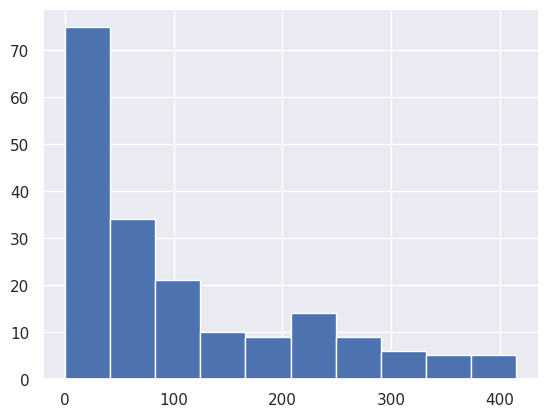

In [21]:
plt.hist(df_all_features_print_modified_overspray['overspray'])

## Normalization and Train Test Split

df_all_features_print[list_inp_features].info()
np.any(np.isfinite(df_all_features_print[list_opt_features]))
df_all_features_print[list_inp_features] = np.nan_to_num(df_all_features_print[list_inp_features])

In [22]:
# df_all_features_print = df_all_features_print.reset_index()

In [23]:
# Set features, targets
from sklearn.model_selection import train_test_split
features = df_all_features_print[list_inp_features]
target = df_all_features_print[list_opt_features]

# set test and train 
x_train, x_test, y_train, y_test = train_test_split(features,target, test_size=0.2 ,random_state=42)

# Feature normalization 
# Here we normalized in a way that all features have the mean zero and standard deviation one 
x_train_std = x_train.std()
x_train_mean = x_train.mean()

x_train_normalized = pd.DataFrame()
for column in range (0,len(x_train.columns)): 
    x_train_normalized[x_train.columns[column]] = (x_train.iloc[:,column]-x_train_mean[column])/x_train_std[column]

    
x_test_normalized = pd.DataFrame()
for column in range (0,len(x_test.columns)): 
    x_test_normalized[x_test.columns[column]] = (x_test.iloc[:,column]-x_train_mean[column])/x_train_std[column]



## ML Algos

### Line width

 This problem is unconstrained.
/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:559: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          391     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.79467D+04    |proj g|=  2.32306D+02

At iterate    1    f=  2.68247D+03    |proj g|=  3.31415D+02

At iterate    2    f=  1.96062D+03    |proj g|=  3.19521D+02

At iterate    3    f=  6.71430D+02    |proj g|=  8.18417D+01

At iterate    4    f=  6.07029D+02    |proj g|=  5.96902D+01

At iterate    5    f=  5.23163D+02    |proj g|=  3.31259D+01

At iterate    6    f=  4.53052D+02    |proj g|=  2.93956D+01

At iterate    7    f=  4.01267D+02    |proj g|=  2.96369D+01

At iterate    8    f=  3.76940D+02    |proj g|=  2.34381D+01

At iterate    9    f=  3.65824D+02    |proj g|=  1.90522D+01

At iterate   10    f=  3.31456D+02    |proj g|=  2.11016D+01

At iterate   11    f=  3.16685D+02    |proj g|=  1.13453D+01

At iterate   12    f=  3.04021D+02    |proj g|=  7.51605D+00

At iterate   13    f=  2.9

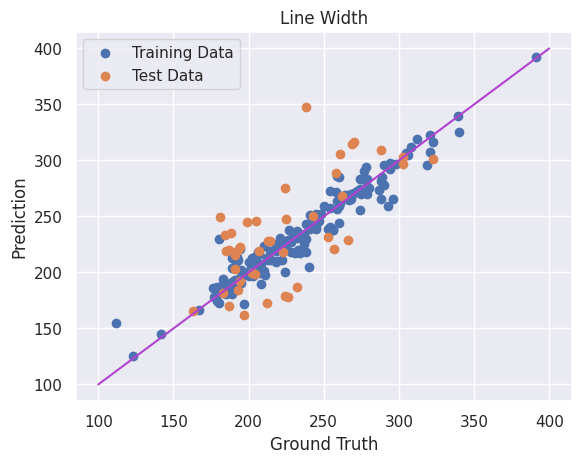

In [24]:
# Here we define ML model

from sklearn.neural_network import MLPRegressor
from sklearn.metrics import r2_score
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error
import math 

mlp_reg = MLPRegressor(activation ='relu',
                        hidden_layer_sizes = (30),
                        alpha = 0.01,
                        learning_rate_init = 0.0001,
                        solver = 'lbfgs',
                        verbose= True,
                        max_iter =500, 
                      random_state=42)

mlp_reg.fit(x_train_normalized, y_train['line_width'])

y_pred_train = mlp_reg.predict(x_train_normalized)
plt.scatter(y_train['line_width'], y_pred_train, label='Training Data')
R2_train = r2_score(y_train['line_width'],y_pred_train)
print('R2_train =', R2_train)
RSME_train = math.sqrt(mean_squared_error(y_train['line_width'],y_pred_train))
print('RSME_train = ',RSME_train)

y_pred_test = mlp_reg.predict(x_test_normalized)
plt.scatter(y_test['line_width'], y_pred_test,label='Test Data')
R2_test = r2_score(y_test['line_width'],y_pred_test)
print('R2_test =', R2_test)
RSME_test = math.sqrt(mean_squared_error(y_test['line_width'],y_pred_test))
print('RSME_test = ',RSME_test)

x = [100,400]
y = [100,400]
plt.plot(x,y, color = '#b043d1')
plt.xlabel('Ground Truth')
plt.ylabel('Prediction')
plt.title('Line Width')
plt.legend()
plt.show()

In [ ]:
R2_train = 0.7631930794208385
RSME_train =  21.44942675039149
R2_test = 0.6359015508438468
RSME_test =  24.502041581763386

### Roughness

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          391     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.53321D+03    |proj g|=  1.00550D+02

At iterate    1    f=  8.00159D+02    |proj g|=  9.32935D+01

At iterate    2    f=  5.76833D+02    |proj g|=  8.12473D+01

At iterate    3    f=  3.91936D+02    |proj g|=  2.73895D+01

At iterate    4    f=  3.73387D+02    |proj g|=  2.81857D+01

At iterate    5    f=  3.36035D+02    |proj g|=  1.49854D+01

At iterate    6    f=  3.16334D+02    |proj g|=  9.88023D+00

At iterate    7    f=  3.11335D+02    |proj g|=  1.65952D+01

At iterate    8    f=  3.00839D+02    |proj g|=  5.07667D+00

At iterate    9    f=  2.98115D+02    |proj g|=  5.40154D+00

At iterate   10    f=  2.93185D+02    |proj g|=  7.53867D+00

At iterate   11    f=  2.88060D+02    |proj g|=  6.21547D+00

At iterate   12    f=  2.82880D+02    |proj g|=  5.08324D+00

At iterate   13    f=  2.7

 This problem is unconstrained.



At iterate  463    f=  5.29136D+01    |proj g|=  3.60639D+00

At iterate  464    f=  5.28446D+01    |proj g|=  3.72175D+00

At iterate  465    f=  5.27556D+01    |proj g|=  3.39756D+00

At iterate  466    f=  5.26716D+01    |proj g|=  3.94085D+00

At iterate  467    f=  5.25917D+01    |proj g|=  3.89742D+00

At iterate  468    f=  5.25370D+01    |proj g|=  4.12566D+00

At iterate  469    f=  5.24324D+01    |proj g|=  3.01303D+00

At iterate  470    f=  5.23524D+01    |proj g|=  4.12455D+00

At iterate  471    f=  5.23288D+01    |proj g|=  3.86704D+00

At iterate  472    f=  5.21785D+01    |proj g|=  2.91536D+00

At iterate  473    f=  5.20348D+01    |proj g|=  3.86802D+00

At iterate  474    f=  5.19226D+01    |proj g|=  3.29039D+00

At iterate  475    f=  5.18296D+01    |proj g|=  3.34808D+00

At iterate  476    f=  5.17397D+01    |proj g|=  3.21000D+00

At iterate  477    f=  5.16422D+01    |proj g|=  3.74195D+00

At iterate  478    f=  5.15813D+01    |proj g|=  3.67022D+00

At iter

/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:559: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


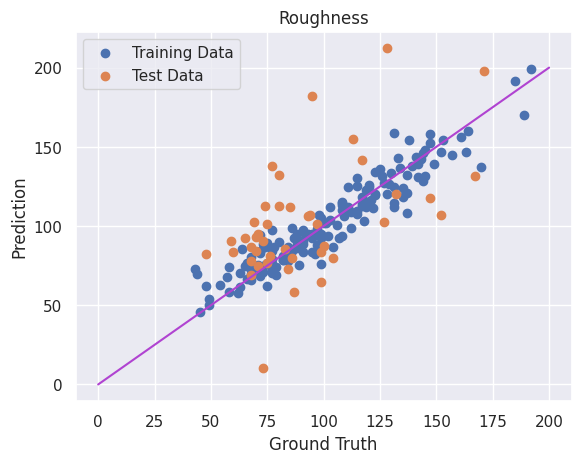

In [25]:
mlp_reg.fit(x_train_normalized, y_train['roughness'])

y_pred_train = mlp_reg.predict(x_train_normalized)
plt.scatter(y_train['roughness'], y_pred_train,label='Training Data')
R2_train = r2_score(y_train['roughness'],y_pred_train)
print('R2_train =', R2_train)
RSME_train = math.sqrt(mean_squared_error(y_train['roughness'],y_pred_train))
print('RSME_train = ',RSME_train)


y_pred_test = mlp_reg.predict(x_test_normalized)
plt.scatter(y_test['roughness'], y_pred_test, label='Test Data')
R2_test = r2_score(y_test['roughness'],y_pred_test)
print('R2_test =', R2_test)
RSME_test = math.sqrt(mean_squared_error(y_test['roughness'],y_pred_test))
print('RSME_test = ',RSME_test)

x = [0,200]
y = [0,200]
plt.plot(x,y, color = '#b043d1')
plt.xlabel('Ground Truth')
plt.ylabel('Prediction')
plt.title('Roughness')
plt.legend()
plt.show()

### Overspray Outlier treatment and normalization

In [26]:
df_all_features_print_os_o = df_all_features_print.drop(df_all_features_print.index[df_all_features_print['overspray'] >450])

# Set features, target
from sklearn.model_selection import train_test_split
features = df_all_features_print_os_o[list_inp_features]
target = df_all_features_print_os_o[list_opt_features]

# set test and train
x_train_os, x_test_os, y_train_os, y_test_os = train_test_split(features,target, test_size=0.2 ,random_state=r_seed)

# Normalization 
x_train_os_std = x_train_os.std()
x_train_os_mean = x_train_os.mean()
x_train_os_normalized = pd.DataFrame()
for column in range (0,len(x_train_os.columns)): # This section reads each column of the input file and calculates the RMS
    x_train_os_normalized[x_train_os.columns[column]] = (x_train_os.iloc[:,column]-x_train_os_mean[column])/x_train_os_std[column]

    

x_test_os_normalized = pd.DataFrame()
for column in range (0,len(x_test_os.columns)): # This section reads each column of the input file and calculates the RMS
    x_test_os_normalized[x_test_os.columns[column]] = (x_test_os.iloc[:,column]-x_train_os_mean[column])/x_train_os_std[column]

  

In [27]:
print(len(df_all_features_print), len(df_all_features_print_os_o))
print(len(x_train_os), len(x_test_os))

211 188
150 38


### Overspray Predict

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          391     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.08079D+04    |proj g|=  9.94811D+01

At iterate    1    f=  5.36893D+03    |proj g|=  6.97086D+01

At iterate    2    f=  5.20601D+03    |proj g|=  6.85108D+01

At iterate    3    f=  4.93087D+03    |proj g|=  5.91782D+01

At iterate    4    f=  4.81540D+03    |proj g|=  3.15804D+01

At iterate    5    f=  4.74839D+03    |proj g|=  3.26941D+01

At iterate    6    f=  4.67470D+03    |proj g|=  3.94262D+01

At iterate    7    f=  4.57770D+03    |proj g|=  3.69520D+01

At iterate    8    f=  4.47715D+03    |proj g|=  2.32441D+01

At iterate    9    f=  4.38490D+03    |proj g|=  1.60886D+01

At iterate   10    f=  4.31702D+03    |proj g|=  1.69047D+01

At iterate   11    f=  4.25172D+03    |proj g|=  1.96472D+01

At iterate   12    f=  4.20944D+03    |proj g|=  1.16079D+01

At iterate   13    f=  4.1

 This problem is unconstrained.
/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:559: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


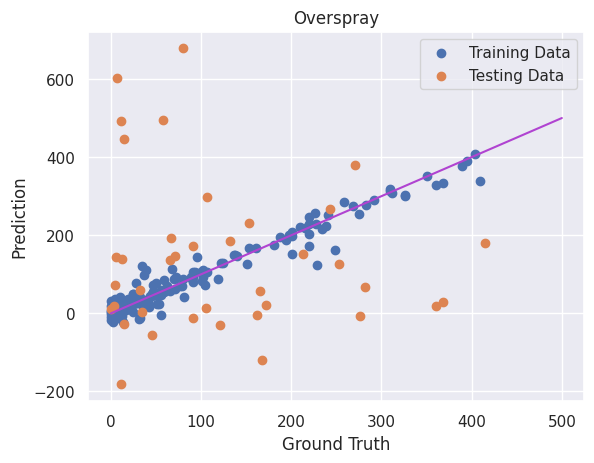

In [28]:
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import r2_score
# instantiate a neural network 
# lbfgs optimizer used to train the neural network- converges well for small data

'''
mlp_reg = MLPRegressor(activation ='relu',
                        hidden_layer_sizes = (30),
                        alpha = 0.01,
                        learning_rate_init = 0.0001,
                        solver = 'lbfgs',
                        verbose= True,
                        max_iter =500, 
                      random_state=r_seed)
'''
mlp_reg.fit(x_train_os_normalized, y_train_os['overspray'])


y_pred_train_os = mlp_reg.predict(x_train_os_normalized)
plt.scatter(y_train_os['overspray'], y_pred_train_os, label='Training Data')
R2_train_os = r2_score(y_train_os['overspray'],y_pred_train_os)
print('R2_train =', R2_train_os)
RSME_train_os = math.sqrt(mean_squared_error(y_train_os['overspray'],y_pred_train_os))
print('RSME_train = ',RSME_train)


y_pred_test_os = mlp_reg.predict(x_test_os_normalized)
plt.scatter(y_test_os['overspray'], y_pred_test_os, label='Testing Data')
R2_test_os = r2_score(y_test_os['overspray'],y_pred_test_os)
print('R2_test =', R2_test_os)
RSME_test_os = math.sqrt(mean_squared_error(y_test_os['overspray'],y_pred_test_os))
print('RSME_test = ',RSME_test_os)

x = [0,500]
y = [0,500]
plt.plot(x,y, color = '#b043d1')
plt.xlabel('Ground Truth')
plt.ylabel('Prediction')
plt.title('Overspray')
plt.legend()
plt.show()

## Local library import
We import all the required local libraries libraries

# Parameter definition
We set all relevant parameters for our notebook. By convention, parameters are uppercase, while all the 
other variables follow Python's guidelines.

# Prediction Algos

In [36]:
def highlight_rows_rmse(row, asking_value):
    cur_value = row.loc['RMSE']
    if cur_value < asking_value:
        color = '#4808c9'
        font_weight = 'normal'
    elif cur_value == asking_value:
        color = '#BAFFC9' 
        font_weight = 'normal'
    else:
        color = '#222222' 
        font_weight = 'normal'
    return [f'color: {color}; font-weight: {font_weight}' for r in row]

## Line width

R2_train = 0.7631930794208385

RSME_train =  21.44942675039149

R2_test = 0.6359015508438468

RSME_test =  24.502041581763386

`paper` : 23.7

In [37]:
#import pyforest
from lazypredict.Supervised import LazyRegressor
from pandas.plotting import scatter_matrix

reg = LazyRegressor(ignore_warnings=False, custom_metric=None)
models, predictions = reg.fit(x_train_normalized, x_test_normalized, y_train['width_line'], y_test['width_line'])

models.reset_index(drop = False, inplace = True)

100%|██████████| 42/42 [00:02<00:00, 14.27it/s]


In [38]:
HTML(models[['Model','Adjusted R-Squared', 'R-Squared', 'RMSE']].style.apply(lambda x: highlight_rows_rmse(x, 24.50),axis=1).to_html())

,Model,Adjusted R-Squared,R-Squared,RMSE
0,BaggingRegressor,0.665906,0.690963,22.573463
1,Lasso,0.624713,0.652860,23.924641
2,PoissonRegressor,0.624413,0.652582,23.934220
3,LGBMRegressor,0.621479,0.649868,24.027500
4,HistGradientBoostingRegressor,0.621479,0.649868,24.027500
5,ElasticNetCV,0.620909,0.649341,24.045590
6,BayesianRidge,0.618056,0.646702,24.135889
7,Ridge,0.616996,0.645722,24.169361
8,RidgeCV,0.616996,0.645722,24.169361
9,LassoCV,0.616296,0.645073,24.191462


## Roughness

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 
R2_train = 0.4661703381670843

RSME_train =  22.759895306737544

R2_test = 0.1668281136369445

RSME_test =  25.982118043893102

`paper` :  19.4

In [39]:
#import pyforest
from lazypredict.Supervised import LazyRegressor
from pandas.plotting import scatter_matrix

reg = LazyRegressor(ignore_warnings=False, custom_metric=None)
models, predictions = reg.fit(x_train_normalized, x_test_normalized, y_train['roughness'], y_test['roughness'])
models.reset_index(drop = False, inplace = True)

100%|██████████| 42/42 [00:01<00:00, 38.17it/s]


In [40]:
HTML(models[['Model','Adjusted R-Squared', 'R-Squared', 'RMSE']].style.apply(lambda x: highlight_rows_rmse(x, 25.98),axis=1).to_html())

,Model,Adjusted R-Squared,R-Squared,RMSE
0,LGBMRegressor,0.383016,0.429290,21.503797
1,HistGradientBoostingRegressor,0.383016,0.429290,21.503797
2,BaggingRegressor,0.350972,0.399649,22.055136
3,OrthogonalMatchingPursuit,0.318119,0.369260,22.606448
4,HuberRegressor,0.305981,0.358033,22.806766
5,PassiveAggressiveRegressor,0.301496,0.353884,22.880344
6,PoissonRegressor,0.300302,0.352780,22.899885
7,LassoCV,0.277561,0.331744,23.269052
8,LarsCV,0.277512,0.331699,23.269840
9,LassoLarsCV,0.277512,0.331699,23.269840


## Overspray

R2_train = 0.475805274317867

RSME_train =  22.759895306737544

R2_test = -0.3540476835932973

RSME_test =  102.78647489238195

`paper` : 67/129

In [41]:
#import pyforest
from lazypredict.Supervised import LazyRegressor
from pandas.plotting import scatter_matrix

reg = LazyRegressor(ignore_warnings=False, custom_metric=None)
models, predictions = reg.fit(x_train_os_normalized, x_test_os_normalized, y_train_os['Overspray'], y_test_os['Overspray'])
models.reset_index(drop = False, inplace = True)

 36%|███▌      | 15/42 [00:00<00:00, 47.00it/s]

GammaRegressor model failed to execute
Some value(s) of y are out of the valid range of the loss 'HalfGammaLoss'.


100%|██████████| 42/42 [00:01<00:00, 38.18it/s]


In [42]:
HTML(models[['Model','Adjusted R-Squared', 'R-Squared', 'RMSE']].style.apply(lambda x: highlight_rows_rmse(x, 102.78),axis=1).to_html())

,Model,Adjusted R-Squared,R-Squared,RMSE
0,NuSVR,-0.078923,0.010988,87.845565
1,LGBMRegressor,-0.096644,-0.005257,88.564070
2,HistGradientBoostingRegressor,-0.096644,-0.005257,88.564070
3,TweedieRegressor,-0.105742,-0.013596,88.930662
4,DummyRegressor,-0.110447,-0.017910,89.119686
5,ElasticNetCV,-0.113340,-0.020561,89.235689
6,ElasticNet,-0.118597,-0.025380,89.446107
7,LassoLars,-0.124876,-0.031137,89.696833
8,BayesianRidge,-0.131091,-0.036834,89.944273
9,KNeighborsRegressor,-0.138784,-0.043885,90.249612


# Oversampling

## SMOTE 1K

In [114]:
from imblearn.over_sampling import SMOTE, RandomOverSampler
import ImbalancedLearningRegression as iblr
import smogn

In [120]:
from imblearn.over_sampling import SMOTE, RandomOverSampler
import ImbalancedLearningRegression as iblr
import smogn

df_all_features_print_normalized_sample_line = smogn.smoter(
    data = df_all_features_print_modified_overspray.iloc[:,:], 
    y = 'line_width',
)

df_all_features_print_normalized_sample_roughness = smogn.smoter(
    data = df_all_features_print_modified_overspray.iloc[:,:], 
    y = 'roughness',
)

df_all_features_print_normalized_sample_overspray = smogn.smoter(
    data = df_all_features_print_modified_overspray.iloc[:,:], 
    y = 'overspray',
)


# Apply the oversampling technique to each target variable separately
# X_resampled_line, y_resampled_line = smote_line.fit_resample(df_all_features_print_normalized[list_inp_features], df_all_features_print_normalized[list_opt_features[0]])
# X_resampled_roughness, y_resampled_roughness = smote_roughness.fit_resample(df_all_features_print_normalized[list_inp_features], df_all_features_print_normalized[list_opt_features[1]])
# X_resampled_spray, y_resampled_spray = smote_spray.fit_resample(df_all_features_print_normalized[list_inp_features], df_all_features_print_normalized[list_opt_features[2]])

# Combine the oversampled datasets for each target variable
# y_resampled = np.hstack((y_resampled_line.values.reshape(-1, 1), y_resampled_roughness.values.reshape(-1, 1), y_resampled_spray.values.reshape(-1, 1)))
# X_resampled = np.vstack((X_resampled_line, X_resampled_roughness, X_resampled_spray))

/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/smogn/smoter.py:200: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  b_index.update({i: y_sort[bumps[i]:bumps[i + 1]]})
/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/smogn/over_sampling.py:128: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  data.iloc[:, j] = pd.Categorical(pd.factorize(
/home/computeruser/anaconda3/envs/atomic/lib/python3.9/site-packages/smogn/over_sampling.py:128: FutureWarning: In a future version, `df.iloc[:

In [123]:
df_all_features_print_normalized_sample_overspray

,print_id,print_height,nozzle_voltage_x,drop_spacing_x,line_width,overspray,roughness,initials,print_head_id,substrate_thickness,...,waveform_file,no_of_layers,ink_visco_cp,ink_visco_pas,surface_tension_dyne_cm,surface_tension_n_m,ink _density,nozzle_diameter,particle_size,z_number
0,162,699,36,9,302,227,151,05.04.22 / A.T,281985.0232.3621.01,200,...,samba waveform_Fataneh 3-3-22,1,6.896373,0.006899,32.308731,0.032298,1613,21.5,36,4.850439
1,161,699,37,8,302,226,151,05.04.22 / A.T,281985.0232.3621.01,200,...,samba waveform_Fataneh 3-3-22,1,6.901862,0.006903,32.298710,0.032288,1614,21.5,36,4.852401
2,166,700,36,16,200,227,104,05.04.22 / A.T,281985.0232.3621.01,200,...,samba waveform_Fataneh 3-3-22,1,6.902260,0.006903,32.297268,0.032293,1614,21.5,36,4.851453
3,168,700,37,15,199,228,103,05.04.22 / A.T,281985.0232.3621.01,200,...,samba waveform_Fataneh 3-3-22,1,6.905566,0.006898,32.309348,0.032303,1613,21.5,36,4.850942
4,153,700,33,8,278,233,100,05.04.22 / A.T,281985.0232.3621.01,200,...,samba waveform_Fataneh 3-3-22,1,6.898145,0.006897,32.286781,0.032298,1614,21.5,36,4.851894
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
177,199,650,28,16,191,81,99,05.26.22 / C.F,281985.0232.3621.01,200,...,samba waveform_Fataneh 3-3-22,1,6.900000,0.006900,32.300000,0.032300,1614,21.5,36,4.852027
178,200,650,28,17,212,282,72,05.26.22 / C.F,281985.0232.3621.01,200,...,samba waveform_Fataneh 3-3-22,1,6.900000,0.006900,32.300000,0.032300,1614,21.5,36,4.852027
179,201,650,31,8,323,47,157,05.31.22 / C.F,281985.0232.3621.01,200,...,samba waveform_Fataneh 3-3-22,1,6.900000,0.006900,32.300000,0.032300,1614,21.5,36,4.852027
181,203,650,31,10,288,107,85,05.31.22 / C.F,281985.0232.3621.01,200,...,samba waveform_Fataneh 3-3-22,1,6.900000,0.006900,32.300000,0.032300,1614,21.5,36,4.852027


In [59]:
# Set features, target
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

features = df_all_features_print_modified_overspray[list_inp_features]
target = df_all_features_print_modified_overspray[list_opt_features]

scaler_norm = StandardScaler()
ary_all_features_print_normalized = scaler_norm.fit_transform(df_all_features_print_modified_overspray[list_inp_features+list_opt_features])

df_all_features_print_normalized = pd.DataFrame(ary_all_features_print_normalized, index=df_all_features_print_modified_overspray.index, columns=[list_inp_features+list_opt_features])

In [69]:
df_all_features_print_normalized[list_inp_features+[list_opt_features[0]]]

,nozzle_voltage_x,distance,ink_visco_cp,ink _density,velocity,drop_spacing_x,surface_tension_dyne_cm,drop_spacing_y,time,cartridge_print_height,nozzle_voltage_y,line_width
0,-1.335952,-1.793171,-1.707825,-1.707825,-0.957976,-1.541502,-1.707825,-1.541502,-1.508307,1.228252,-1.335952,1.478566
1,-1.335952,-1.793171,-1.707825,-1.707825,-0.957976,-1.194848,-1.707825,-1.194848,-1.508307,1.228252,-1.335952,0.723709
2,-1.335952,-1.679511,-1.707825,-1.707825,-0.975453,-0.848195,-1.707825,-0.848195,-1.345854,1.228252,-1.335952,-0.259893
3,-1.335952,-1.679511,-1.707825,-1.707825,-1.384642,-0.501541,-1.707825,-0.501541,-1.102174,1.228252,-1.335952,-0.900377
4,-1.335952,-1.679511,-1.707825,-1.707825,-1.195055,-0.154888,-1.707825,-0.154888,-1.224014,1.228252,-1.335952,-0.900377
...,...,...,...,...,...,...,...,...,...,...,...,...
206,-0.145625,0.593693,0.585540,0.585540,-0.413151,-0.154888,0.585540,-0.154888,1.009714,-1.634286,-0.145625,0.746583
207,-0.145625,0.593693,0.585540,0.585540,-0.413151,0.191766,0.585540,0.191766,1.009714,-1.634286,-0.145625,0.266220
208,-0.145625,0.593693,0.585540,0.585540,-0.413151,0.538419,0.585540,0.538419,1.009714,-1.634286,-0.145625,-0.877503
209,-0.145625,0.593693,0.585540,0.585540,-0.808916,1.231726,0.585540,1.231726,1.497073,-1.634286,-0.145625,-0.946126


In [117]:
df_all_features_print_modified_overspray.reset_index(drop = True, inplace = True)

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [49]:
smote_line = SMOTE( random_state=42)
smote_roughness = RandomOverSampler(sampling_strategy='minority', random_state=42)
smote_spray = RandomOverSampler(sampling_strategy='minority', random_state=42)

# Apply the oversampling technique to each target variable separately
X_resampled_line, y_resampled_line = smote_line.fit_resample(df_all_features_print_normalized[list_inp_features], df_all_features_print_normalized[list_opt_features[0]])
X_resampled_roughness, y_resampled_roughness = smote_roughness.fit_resample(df_all_features_print_normalized[list_inp_features], df_all_features_print_normalized[list_opt_features[1]])
X_resampled_spray, y_resampled_spray = smote_spray.fit_resample(df_all_features_print_normalized[list_inp_features], df_all_features_print_normalized[list_opt_features[2]])

# Combine the oversampled datasets for each target variable
y_resampled = np.hstack((y_resampled_line.values.reshape(-1, 1), y_resampled_roughness.values.reshape(-1, 1), y_resampled_spray.values.reshape(-1, 1)))
X_resampled = np.vstack((X_resampled_line, X_resampled_roughness, X_resampled_spray))

ValueError: Unknown label type: 'continuous'

In [46]:
df_all_features_print_normalized

,nozzle_voltage_x,distance,ink_visco_cp,ink _density,velocity,drop_spacing_x,surface_tension_dyne_cm,drop_spacing_y,time,cartridge_print_height,nozzle_voltage_y,line_width,roughness,overspray
0,-1.335952,-1.793171,-1.707825,-1.707825,-0.957976,-1.541502,-1.707825,-1.541502,-1.508307,1.228252,-1.335952,1.478566,2.149737,-0.845568
1,-1.335952,-1.793171,-1.707825,-1.707825,-0.957976,-1.194848,-1.707825,-1.194848,-1.508307,1.228252,-1.335952,0.723709,1.400163,0.283858
2,-1.335952,-1.679511,-1.707825,-1.707825,-0.975453,-0.848195,-1.707825,-0.848195,-1.345854,1.228252,-1.335952,-0.259893,0.161737,-0.854676
3,-1.335952,-1.679511,-1.707825,-1.707825,-1.384642,-0.501541,-1.707825,-0.501541,-1.102174,1.228252,-1.335952,-0.900377,-0.978918,-0.818243
4,-1.335952,-1.679511,-1.707825,-1.707825,-1.195055,-0.154888,-1.707825,-0.154888,-1.224014,1.228252,-1.335952,-0.900377,-0.261935,-0.126014
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
206,-0.145625,0.593693,0.585540,0.585540,-0.413151,-0.154888,0.585540,-0.154888,1.009714,-1.634286,-0.145625,0.746583,-0.131574,-0.800026
207,-0.145625,0.593693,0.585540,0.585540,-0.413151,0.191766,0.585540,0.191766,1.009714,-1.634286,-0.145625,0.266220,-0.392295,-0.818243
208,-0.145625,0.593693,0.585540,0.585540,-0.413151,0.538419,0.585540,0.538419,1.009714,-1.634286,-0.145625,-0.877503,-0.359705,-0.253530
209,-0.145625,0.593693,0.585540,0.585540,-0.808916,1.231726,0.585540,1.231726,1.497073,-1.634286,-0.145625,-0.946126,-0.815967,-0.945759


In [ ]:

# set test and train
x_train_norm_os, x_test_norm_os, y_train_norm_os, y_test_norm_os = train_test_split(
    df_all_features_print_modified_overspray[list_inp_features],
    df_all_features_print_modified_overspray[list_opt_features], 
    test_size=0.2 ,random_state=42
    )

#  Interpretation

## PDP

### Generalized additive models
- https://pygam.readthedocs.io/en/latest/notebooks/tour_of_pygam.html

In [51]:
from pygam import LinearGAM, LogisticGAM

100% (205 of 205) |######################| Elapsed Time: 0:00:02 Time:  0:00:02


<Figure size 640x480 with 0 Axes>

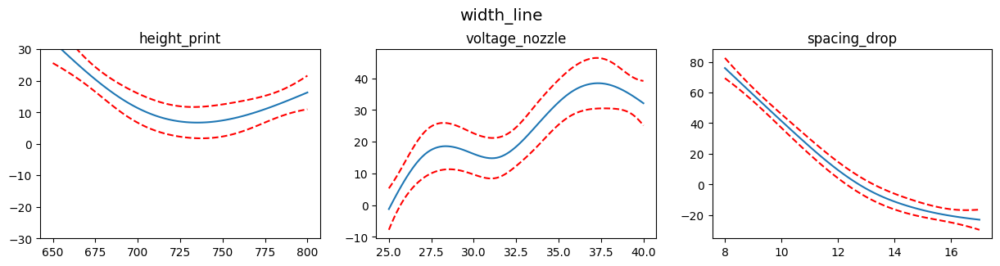

In [80]:
target_to_analyze = 'width_line'

lams = np.random.rand(len(df_features), 3)
lams = lams * 3
lams = np.exp(lams)
gam = LinearGAM(n_splines=10).gridsearch(df_features[columns_features].values, df_features[target_to_analyze].values, lam=lams)


titles = columns_features#redwine.columns[0:11]
plt.figure()
fig, axs = plt.subplots(1,3,figsize=(15, 3))
st = fig.suptitle(target_to_analyze, fontsize='x-large')

for i, ax in enumerate(axs):
    XX = gam.generate_X_grid(term=i)
    ax.plot(XX[:, i], gam.partial_dependence(term=i, X=XX))
    ax.plot(XX[:, i], gam.partial_dependence(term=i, X=XX, width=.95)[1], c='r', ls='--')
    if i == 0:
        ax.set_ylim(-30,30)
    ax.set_title(titles[i])
    
st.set_y(1.05)
plt.show()

100% (205 of 205) |######################| Elapsed Time: 0:00:02 Time:  0:00:02


<Figure size 640x480 with 0 Axes>

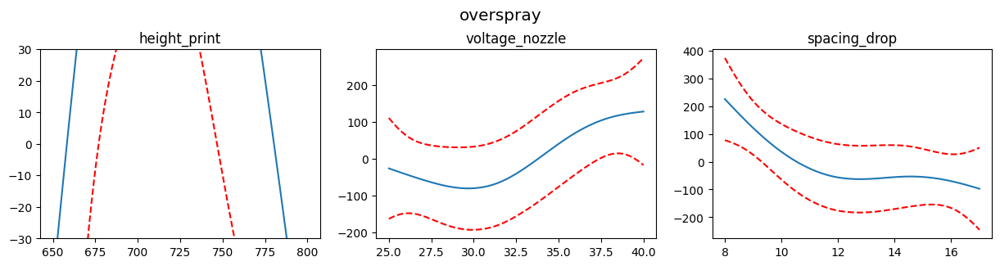

In [81]:
target_to_analyze = 'overspray'

lams = np.random.rand(len(df_features), 3)
lams = lams * 3
lams = np.exp(lams)
gam = LinearGAM(n_splines=10).gridsearch(df_features[columns_features].values, df_features[target_to_analyze].values, lam=lams)


titles = columns_features#redwine.columns[0:11]
plt.figure()
fig, axs = plt.subplots(1,3,figsize=(15, 3))
st = fig.suptitle(target_to_analyze, fontsize='x-large')

for i, ax in enumerate(axs):
    XX = gam.generate_X_grid(term=i)
    ax.plot(XX[:, i], gam.partial_dependence(term=i, X=XX))
    ax.plot(XX[:, i], gam.partial_dependence(term=i, X=XX, width=.95)[1], c='r', ls='--')
    if i == 0:
        ax.set_ylim(-30,30)
    ax.set_title(titles[i])
    
st.set_y(1.05)
plt.show()

100% (205 of 205) |######################| Elapsed Time: 0:00:02 Time:  0:00:02


<Figure size 640x480 with 0 Axes>

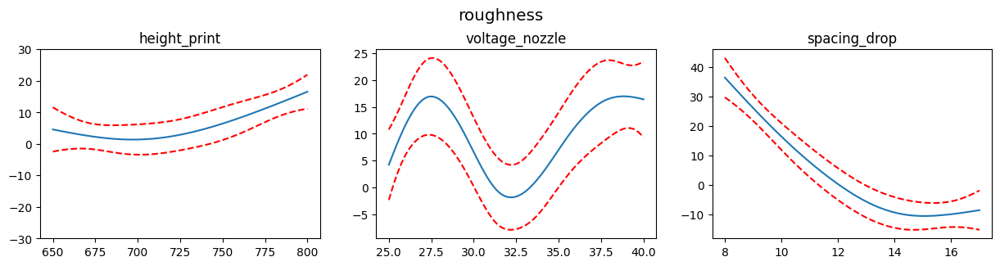

In [82]:
target_to_analyze = 'roughness'

lams = np.random.rand(len(df_features), 3)
lams = lams * 3
lams = np.exp(lams)
gam = LinearGAM(n_splines=10).gridsearch(df_features[columns_features].values, df_features[target_to_analyze].values, lam=lams)


titles = columns_features#redwine.columns[0:11]
plt.figure()
fig, axs = plt.subplots(1,3,figsize=(15, 3))
st = fig.suptitle(target_to_analyze, fontsize='x-large')

for i, ax in enumerate(axs):
    XX = gam.generate_X_grid(term=i)
    ax.plot(XX[:, i], gam.partial_dependence(term=i, X=XX))
    ax.plot(XX[:, i], gam.partial_dependence(term=i, X=XX, width=.95)[1], c='r', ls='--')
    if i == 0:
        ax.set_ylim(-30,30)
    ax.set_title(titles[i])
    
st.set_y(1.05)
plt.show()

### sklearn :: mlp

In [116]:
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler#MinMaxScaler#StandardScaler
from sklearn.neural_network import MLPRegressor

In [129]:
target_to_analyze = 'width_line'

est = make_pipeline(
    StandardScaler(),
    MLPRegressor(
        hidden_layer_sizes=( 70, 30),
        learning_rate_init=0.01,
        solver='adam',
        early_stopping=False,
        random_state=r_seed,
    ),
)
est.fit(df_features[columns_features], df_features[target_to_analyze])

print(f"Test R2 score: {est.score(df_features[columns_features], df_features[target_to_analyze]):.2f}")

Test R2 score: 0.67


<Figure size 640x480 with 0 Axes>

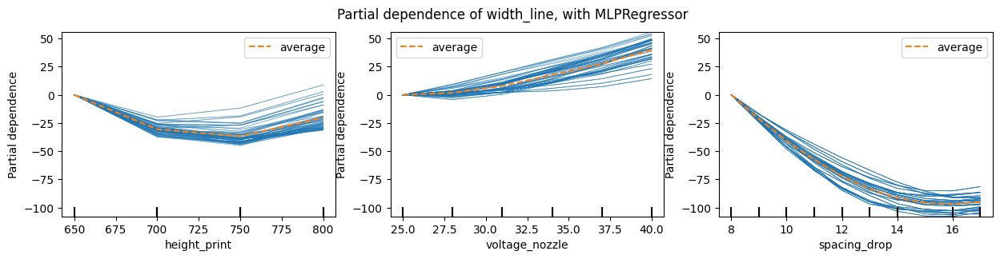

In [142]:
from sklearn.inspection import PartialDependenceDisplay

common_params = {
    "subsample": 200,
    "n_jobs": 2,
    "grid_resolution": 40,
    "centered": True,
    "random_state": r_seed,
}

plt.figure()
fig, axs = plt.subplots(1,3,figsize=(15, 3))

display = PartialDependenceDisplay.from_estimator(
    est,
    df_features[columns_features],
    features=columns_features,
    kind="both",
    **common_params,ax = axs
)

display.figure_.suptitle(f'Partial dependence of {target_to_analyze}, with MLPRegressor')
display.figure_.subplots_adjust(hspace=0.3)

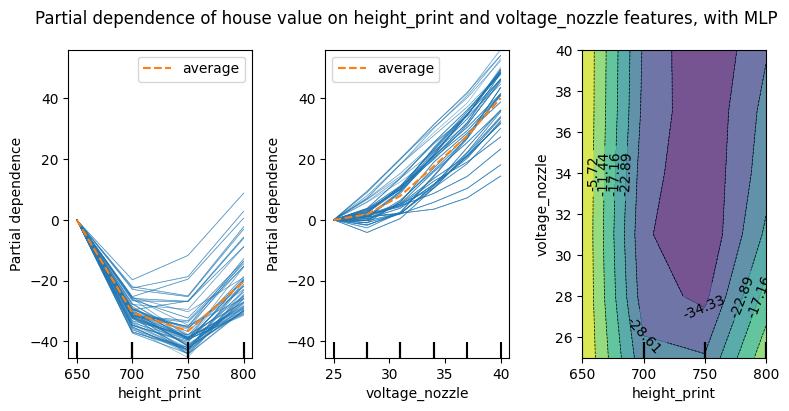

In [146]:
_, ax = plt.subplots(ncols=3, figsize=(9, 4))

# Note that we could have called the method `from_estimator` three times and
# provide one feature, one kind of plot, and one axis for each call.
display = PartialDependenceDisplay.from_estimator(
    est,
    df_features[columns_features],
    features=["height_print", "voltage_nozzle", ("height_print", "voltage_nozzle")],
    kind=["both", "both", "average"],
    ax=ax,
    **common_params,
)

display.figure_.suptitle(
    f"Partial dependence of house value on height_print and voltage_nozzle features, with MLP"
)
display.figure_.subplots_adjust(wspace=0.4, hspace=0.3)


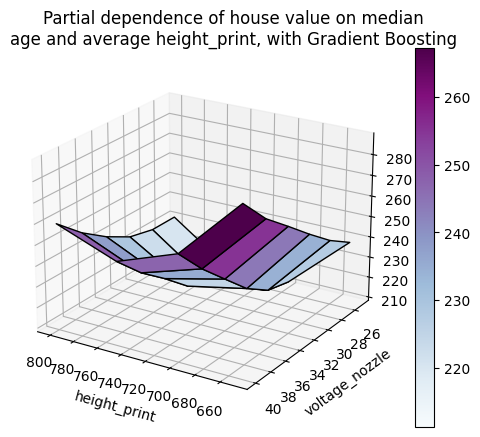

In [148]:
# unused but required import for doing 3d projections with matplotlib < 3.2
import mpl_toolkits.mplot3d  # noqa: F401

from sklearn.inspection import partial_dependence

fig = plt.figure()

features = ("height_print", "voltage_nozzle")
pdp = partial_dependence(
    est, df_features[columns_features], features=features, kind="average", grid_resolution=10
)
XX, YY = np.meshgrid(pdp["values"][0], pdp["values"][1])
Z = pdp.average[0].T
ax = fig.add_subplot(projection="3d")
fig.add_axes(ax)

surf = ax.plot_surface(XX, YY, Z, rstride=1, cstride=1, cmap=plt.cm.BuPu, edgecolor="k")
ax.set_xlabel(features[0])
ax.set_ylabel(features[1])
ax.set_zlabel("Partial dependence")
# pretty init view
ax.view_init(elev=22, azim=122)
plt.colorbar(surf)
plt.suptitle(
    "Partial dependence of house value on median\n"
    "age and average height_print, with Gradient Boosting"
)
plt.subplots_adjust(top=0.9)
plt.show()


### SHAP

  0%|          | 0/37 [00:00<?, ?it/s]

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


ValueError: Unable to determine Axes to steal space for Colorbar. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.

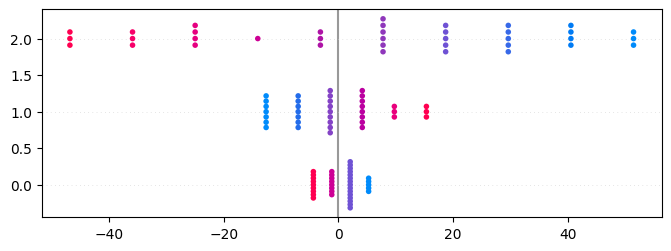

In [294]:
from sklearn import linear_model
import shap

lin_regr = linear_model.LinearRegression()
lin_regr.fit(x_train_normalized.values, y_train['width_line'].values)

## Explaining all the instances
x_train_normalized_summary = shap.kmeans(x_train_normalized, 10)
ex = shap.KernelExplainer(lin_regr.predict, x_train_normalized_summary)

shap_values = ex.shap_values(x_test_normalized)
shap.summary_plot(shap_values, x_test_normalized, show=False)
plt.gcf().axes[-1].set_aspect(100)
plt.gcf().axes[-1].set_box_aspect(100)

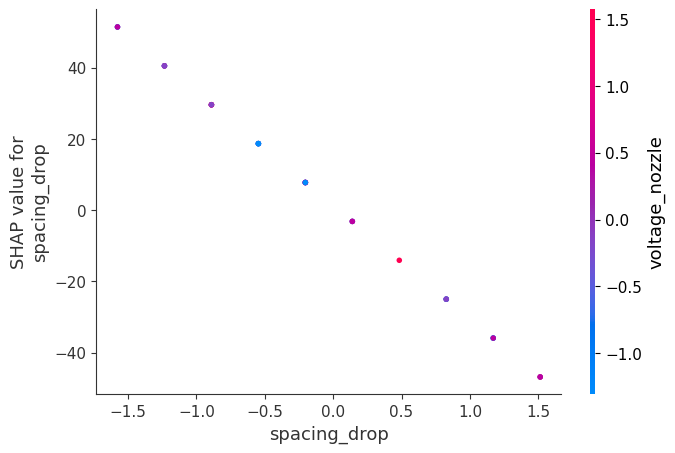

In [303]:
shap.dependence_plot("spacing_drop", shap_values, x_test_normalized)

# References
We report here relevant references:
1. author1, article1, journal1, year1, url1
2. author2, article2, journal2, year2, url2

In [305]:
!/home/computeruser/anaconda3/envs/atomic/bin/pip install lazypredict

  Using cached lazypredict-0.2.9-py2.py3-none-any.whl (12 kB)
  Using cached six-1.15.0-py2.py3-none-any.whl (10 kB)
  Using cached pandas-1.0.5.tar.gz (5.0 MB)
  Installing build dependencies ... done
  Getting requirements to build wheel ... |^C
anceled
ERROR: Operation cancelled by user


In [289]:
import matplotlib
matplotlib.__version__

'3.6.0'

In [25]:
pd.DataFrame([{'ml_algo':1, 'train_acc':2}, {'ml_algo': 100, 'train_acc':200}])

,ml_algo,train_acc
0,1,2
1,100,200


In [44]:
!/home/computeruser/anaconda3/envs/atomic/bin/pip install imbalanced-learn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 226.0/226.0 kB 4.6 MB/s eta 0:00:00a 0:00:01
  Using cached joblib-1.2.0-py3-none-any.whl (297 kB)
  Attempting uninstall: joblib
    Found existing installation: joblib 1.0.0
    Uninstalling joblib-1.0.0:
      Successfully uninstalled joblib-1.0.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
lazypredict 0.2.9 requires joblib==1.0.0, but you have joblib 1.2.0 which is incompatible.
lazypredict 0.2.9 requires PyYAML==5.4, but you have pyyaml 6.0 which is incompatible.
lazypredict 0.2.9 requires six==1.15.0, but you have six 1.16.0 which is incompatible.


In [49]:
# check version number
#Smooth
from imblearn.over_sampling import RandomOverSampler
oversample = RandomOverSampler(sampling_strategy=0.5)
X_over, y_over = oversample.fit_resample(Print_Database[['Print Height','Nozzle Voltage','Drop Spacing']].add_suffixvalues, Print_Database['Overspray'])

ValueError: "sampling_strategy" can be a float only when the type of target is binary. For multi-class, use a dict.